In [2]:
## Import Libraries
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler,MinMaxScaler, LabelEncoder
from sklearn.compose import ColumnTransformer
import ipaddress
import logging

In [4]:
# Load Datasets
def load_datasets():
    credit_card_df = pd.read_csv('../Data/creditcard.csv')
    fraud_data_df = pd.read_csv('../Data/Fraud_Data.csv')
    ip_address_df = pd.read_csv('../Data/IpAddress_to_Country.csv')
    return credit_card_df, fraud_data_df, ip_address_df
# Load datasets
credit_card_df, fraud_data_df, ip_address_df = load_datasets()

In [3]:
# Function to load and analyze data
def analyze_data(file_path):
    try:
        df = pd.read_csv(file_path)
        print(f"Data from {file_path}")
        print("\nHead of the DataFrame:")
        display(df.head())
        print("\nInfo of the DataFrame:")
        display(df.info())
        print("\nDescribe the DataFrame:")
        display(df.describe(include='all'))
    except Exception as e:
        print(f"Error processing file {file_path}: {e}")

# Analyze creditcard dataset
print("Analyzing creditcard dataset")
analyze_data('../data/creditcard.csv')
print("="*80)

Analyzing creditcard dataset
Data from ../data/creditcard.csv

Head of the DataFrame:


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0



Info of the DataFrame:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null 

None


Describe the DataFrame:


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.168375e-15,3.416908e-16,-1.379537e-15,2.074095e-15,9.604066e-16,1.487313e-15,-5.556467e-16,1.213481e-16,-2.406331e-15,...,1.654067e-16,-3.568593e-16,2.578648e-16,4.473266e-15,5.340915e-16,1.683437e-15,-3.660091e-16,-1.227390e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


In [4]:
# fraud_data_df 
print("Analyzing fraud_data dataset")
analyze_data('../data/Fraud_Data.csv')
print("="*80)

Analyzing fraud_data dataset
Data from ../data/Fraud_Data.csv

Head of the DataFrame:


,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,age,ip_address,class
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,34,QVPSPJUOCKZAR,SEO,Chrome,M,39,7.327584e+08,0
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,16,EOGFQPIZPYXFZ,Ads,Chrome,F,53,3.503114e+08,0
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,15,YSSKYOSJHPPLJ,SEO,Opera,M,53,2.621474e+09,1
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,44,ATGTXKYKUDUQN,SEO,Safari,M,41,3.840542e+09,0
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,39,NAUITBZFJKHWW,Ads,Safari,M,45,4.155831e+08,0



Info of the DataFrame:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 151112 entries, 0 to 151111
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   user_id         151112 non-null  int64  
 1   signup_time     151112 non-null  object 
 2   purchase_time   151112 non-null  object 
 3   purchase_value  151112 non-null  int64  
 4   device_id       151112 non-null  object 
 5   source          151112 non-null  object 
 6   browser         151112 non-null  object 
 7   sex             151112 non-null  object 
 8   age             151112 non-null  int64  
 9   ip_address      151112 non-null  float64
 10  class           151112 non-null  int64  
dtypes: float64(1), int64(4), object(6)
memory usage: 12.7+ MB


None


Describe the DataFrame:


,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,age,ip_address,class
count,151112.000000,151112,151112,151112.000000,151112,151112,151112,151112,151112.000000,1.511120e+05,151112.000000
unique,NaN,151112,150679,NaN,137956,3,5,2,NaN,NaN,NaN
top,NaN,2015-06-10 07:02:20,2015-07-17 23:22:55,NaN,ITUMJCKWEYNDD,SEO,Chrome,M,NaN,NaN,NaN
freq,NaN,1,3,NaN,20,60615,61432,88293,NaN,NaN,NaN
mean,200171.040970,NaN,NaN,36.935372,NaN,NaN,NaN,NaN,33.140704,2.152145e+09,0.093646
std,115369.285024,NaN,NaN,18.322762,NaN,NaN,NaN,NaN,8.617733,1.248497e+09,0.291336
min,2.000000,NaN,NaN,9.000000,NaN,NaN,NaN,NaN,18.000000,5.209350e+04,0.000000
25%,100642.500000,NaN,NaN,22.000000,NaN,NaN,NaN,NaN,27.000000,1.085934e+09,0.000000
50%,199958.000000,NaN,NaN,35.000000,NaN,NaN,NaN,NaN,33.000000,2.154770e+09,0.000000
75%,300054.000000,NaN,NaN,49.000000,NaN,NaN,NaN,NaN,39.000000,3.243258e+09,0.000000


In [5]:
 # ip_address_df 
print("Analyzing IpAddress_to_Country dataset")
analyze_data('../data/IpAddress_to_Country.csv')
print("="*80)

Analyzing IpAddress_to_Country dataset
Data from ../data/IpAddress_to_Country.csv

Head of the DataFrame:


,lower_bound_ip_address,upper_bound_ip_address,country
0,16777216.0,16777471,Australia
1,16777472.0,16777727,China
2,16777728.0,16778239,China
3,16778240.0,16779263,Australia
4,16779264.0,16781311,China



Info of the DataFrame:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 138846 entries, 0 to 138845
Data columns (total 3 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   lower_bound_ip_address  138846 non-null  float64
 1   upper_bound_ip_address  138846 non-null  int64  
 2   country                 138846 non-null  object 
dtypes: float64(1), int64(1), object(1)
memory usage: 3.2+ MB


None


Describe the DataFrame:


,lower_bound_ip_address,upper_bound_ip_address,country
count,1.388460e+05,1.388460e+05,138846
unique,NaN,NaN,235
top,NaN,NaN,United States
freq,NaN,NaN,46868
mean,2.724532e+09,2.724557e+09,NaN
std,8.975215e+08,8.974979e+08,NaN
min,1.677722e+07,1.677747e+07,NaN
25%,1.919930e+09,1.920008e+09,NaN
50%,3.230887e+09,3.230888e+09,NaN
75%,3.350465e+09,3.350466e+09,NaN


In [6]:
def check_missing_values(df):
    """
    Checks for missing values in the three DataFrames and displays the results.

    Args:
        credit_card_df (pd.DataFrame): The creditcard.csv DataFrame.
        fraud_data_df (pd.DataFrame): The Fraud_Data.csv DataFrame.
        ip_address_df (pd.DataFrame): The IpAddress_to_Country.csv DataFrame.
    """
    
    print(df.isnull().sum())
print("Missing Values in Credit Card DataFrame:")
check_missing_values(credit_card_df)

Missing Values in Credit Card DataFrame:
Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64


In [7]:
print("\nMissing Values in Fraud Data DataFrame:")
check_missing_values( fraud_data_df)


Missing Values in Fraud Data DataFrame:
user_id           0
signup_time       0
purchase_time     0
purchase_value    0
device_id         0
source            0
browser           0
sex               0
age               0
ip_address        0
class             0
dtype: int64


In [8]:
print("\nMissing Values in IP Address DataFrame:")
check_missing_values( ip_address_df)


Missing Values in IP Address DataFrame:
lower_bound_ip_address    0
upper_bound_ip_address    0
country                   0
dtype: int64


In [9]:
# Handle Missing Values
def handle_missing_values(df):
    return df.dropna()

# Example usage
credit_card_df = handle_missing_values(credit_card_df)
fraud_data_df = handle_missing_values(fraud_data_df)
ip_address_df= handle_missing_values(ip_address_df)

In [10]:
# Data Cleaning
def clean_data(df):
    return df.drop_duplicates()

# Example usage
credit_card_df = clean_data(credit_card_df)
fraud_data_df = clean_data(fraud_data_df)
ip_address_df= clean_data(ip_address_df)

In [11]:
# Correct Data Types
def correct_data_types(fraud_data_df):
    fraud_data_df['signup_time'] = pd.to_datetime(fraud_data_df['signup_time'])
    fraud_data_df['purchase_time'] = pd.to_datetime(fraud_data_df['purchase_time'])
    fraud_data_df['ip_address'] = fraud_data_df['ip_address'].apply(int)
    return fraud_data_df

In [12]:
fraud_data_df = correct_data_types(fraud_data_df)

In [13]:
fraud_data_df 

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,age,ip_address,class
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,34,QVPSPJUOCKZAR,SEO,Chrome,M,39,732758368,0
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,16,EOGFQPIZPYXFZ,Ads,Chrome,F,53,350311387,0
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,15,YSSKYOSJHPPLJ,SEO,Opera,M,53,2621473820,1
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,44,ATGTXKYKUDUQN,SEO,Safari,M,41,3840542443,0
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,39,NAUITBZFJKHWW,Ads,Safari,M,45,415583117,0
...,...,...,...,...,...,...,...,...,...,...,...
151107,345170,2015-01-27 03:03:34,2015-03-29 00:30:47,43,XPSKTWGPWINLR,SEO,Chrome,M,28,3451154526,1
151108,274471,2015-05-15 17:43:29,2015-05-26 12:24:39,35,LYSFABUCPCGBA,SEO,Safari,M,32,2439047221,0
151109,368416,2015-03-03 23:07:31,2015-05-20 07:07:47,40,MEQHCSJUBRBFE,SEO,IE,F,26,2748470523,0
151110,207709,2015-07-09 20:06:07,2015-09-07 09:34:46,46,CMCXFGRHYSTVJ,SEO,Chrome,M,37,3601174708,0


In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

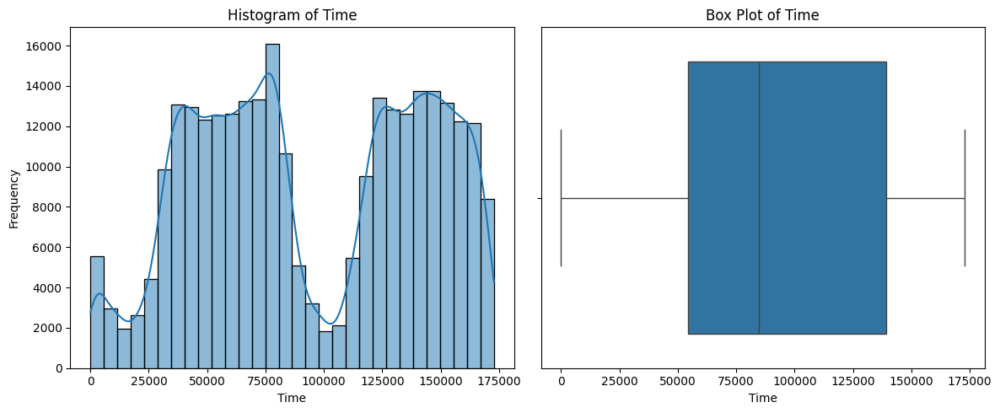

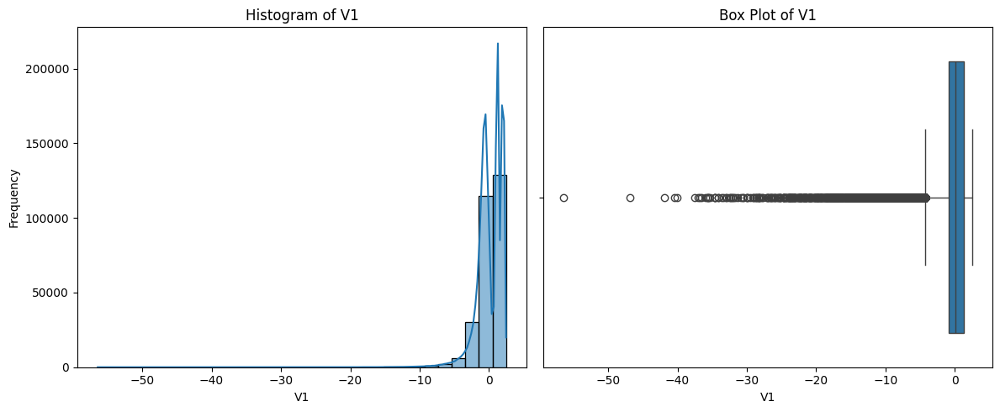

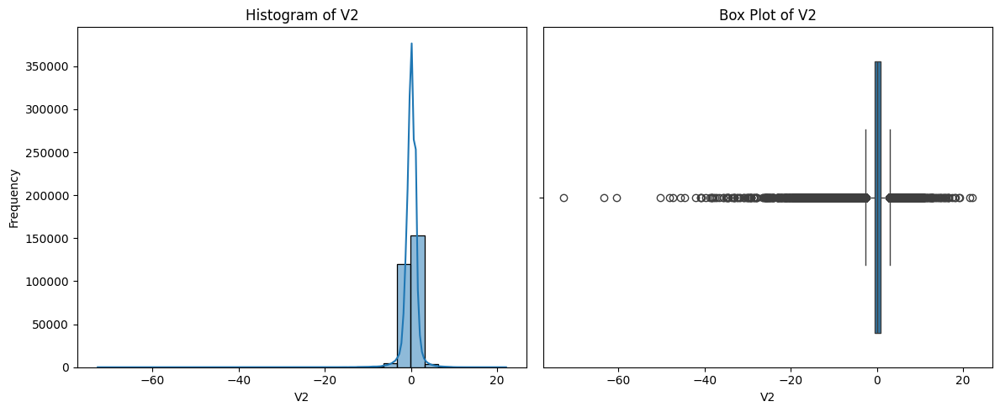

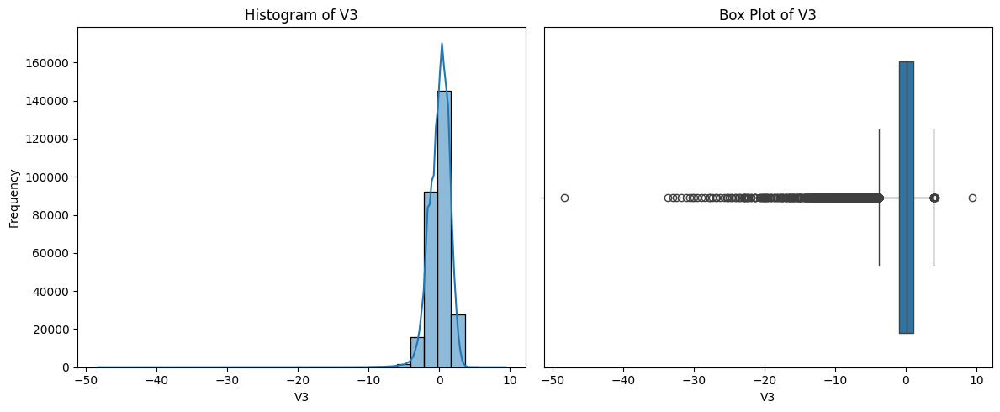

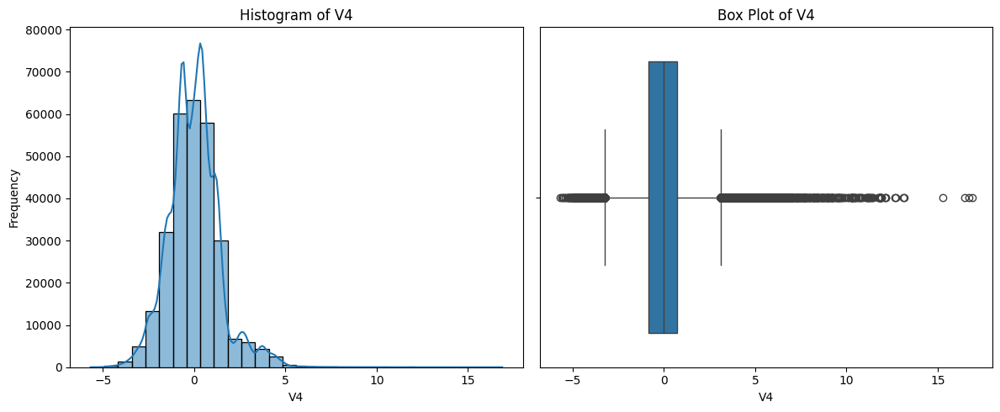

...

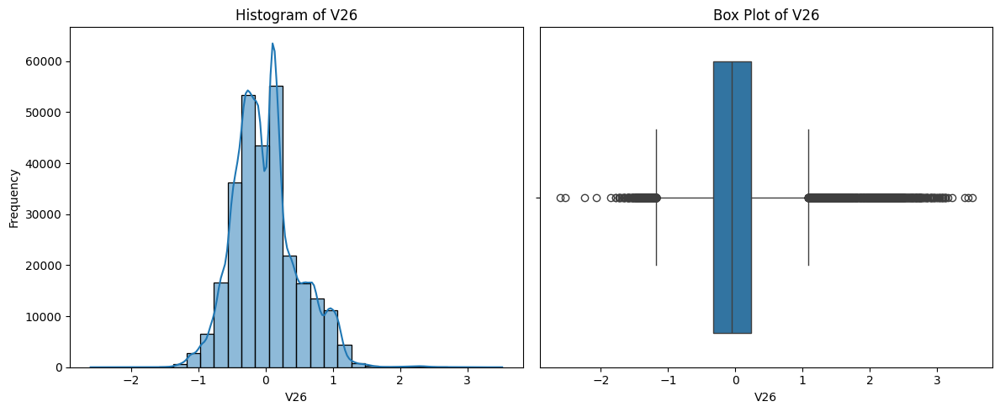

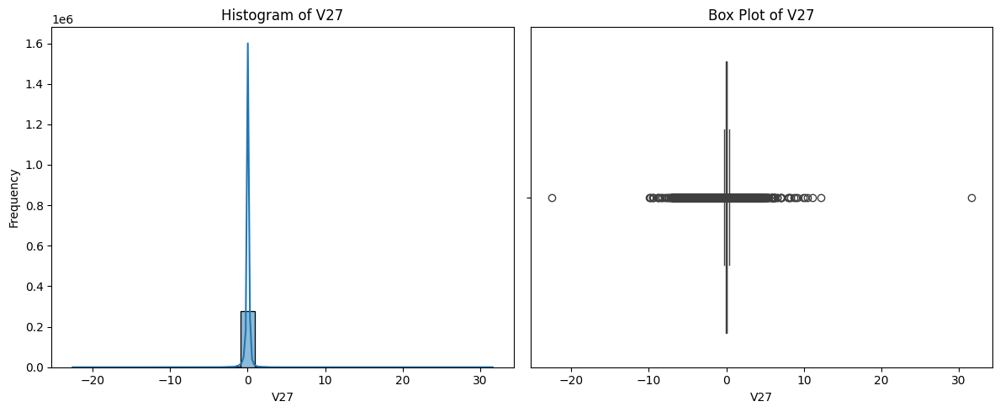

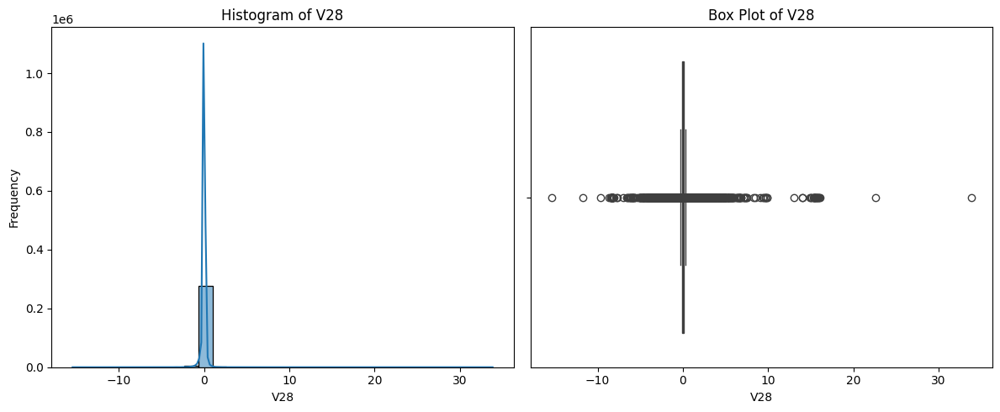

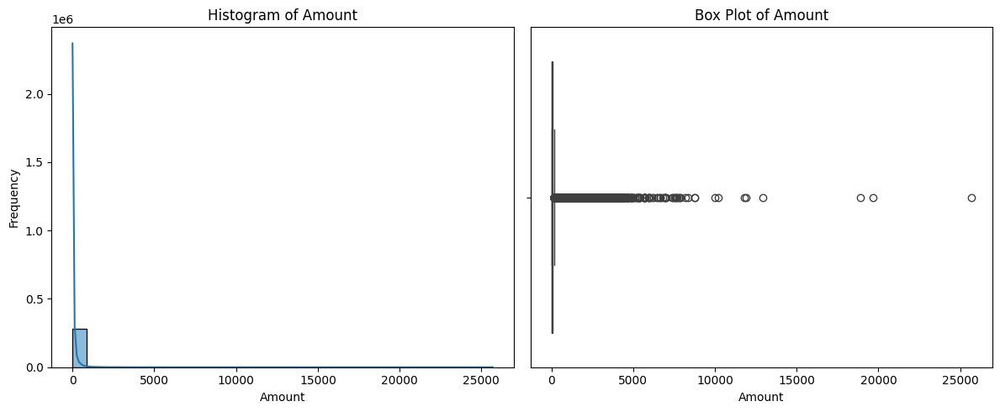

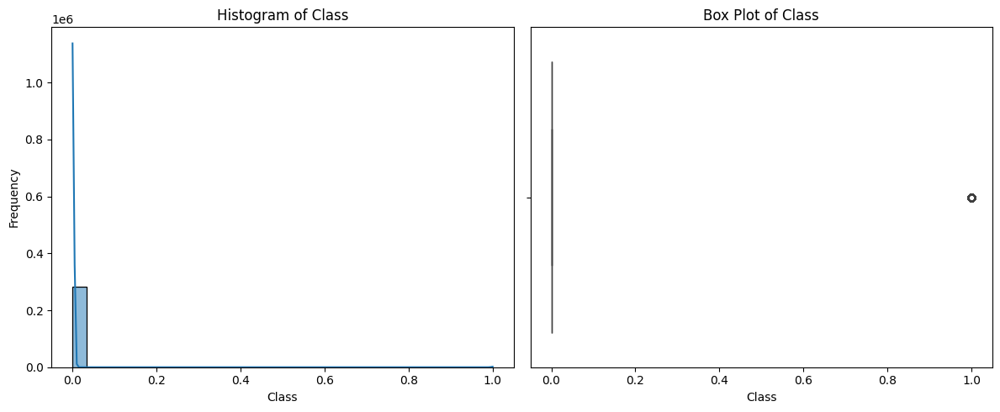

In [15]:
# For numerical columns: Histogram and Box Plot
numerical_colscredit =credit_card_df.select_dtypes(include=[np.number]).columns
numerical_colsfraud =fraud_data_df.select_dtypes(include=[np.number]).columns
numerical_colsip =ip_address_df.select_dtypes(include=[np.number]).columns
for col in numerical_colscredit:
    plt.figure(figsize=(12, 5))

    # Histogram
    plt.subplot(1, 2, 1)
    sns.histplot(credit_card_df[col], bins=30, kde=True)
    plt.title(f'Histogram of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')

    # Box Plot
    plt.subplot(1, 2, 2)
    sns.boxplot(x=credit_card_df[col])
    plt.title(f'Box Plot of {col}')
    plt.xlabel(col)

    plt.tight_layout()
    plt.show()

In [24]:
# For categorical columns: Bar Plot
categorical_cols = credit_card_df.select_dtypes(include=[object]).columns

for col in categorical_cols:
    plt.figure(figsize=(8, 5))
    sns.countplot(y=credit_card_df[col], order=credit_card_df[col].value_counts().index)
    plt.title(f'Count Plot of {col}')
    plt.xlabel('Count')
    plt.ylabel(col)
    plt.show()

In [17]:
# Exploratory Data Analysis (EDA)
def univariate_analysis(df):
    return df.describe()

 
print("Credit Card Data - Univariate Analysis:")
print(univariate_analysis(credit_card_df))

Credit Card Data - Univariate Analysis:
                Time             V1             V2             V3  \
count  283726.000000  283726.000000  283726.000000  283726.000000   
mean    94811.077600       0.005917      -0.004135       0.001613   
std     47481.047891       1.948026       1.646703       1.508682   
min         0.000000     -56.407510     -72.715728     -48.325589   
25%     54204.750000      -0.915951      -0.600321      -0.889682   
50%     84692.500000       0.020384       0.063949       0.179963   
75%    139298.000000       1.316068       0.800283       1.026960   
max    172792.000000       2.454930      22.057729       9.382558   

                  V4             V5             V6             V7  \
count  283726.000000  283726.000000  283726.000000  283726.000000   
mean       -0.002966       0.001828      -0.001139       0.001801   
std         1.414184       1.377008       1.331931       1.227664   
min        -5.683171    -113.743307     -26.160506     -43.557

In [18]:
print("Fraud Data - Univariate Analysis:")
print(univariate_analysis(fraud_data_df))

Fraud Data - Univariate Analysis:
             user_id                    signup_time  \
count  151112.000000                         151112   
mean   200171.040970  2015-04-20 00:56:09.511329280   
min         2.000000            2015-01-01 00:00:42   
25%    100642.500000     2015-02-18 09:52:48.500000   
50%    199958.000000            2015-04-19 04:41:30   
75%    300054.000000  2015-06-18 14:47:22.750000128   
max    400000.000000            2015-08-18 04:40:29   
std    115369.285024                            NaN   

                       purchase_time  purchase_value            age  \
count                         151112   151112.000000  151112.000000   
mean   2015-06-16 02:56:38.759952896       36.935372      33.140704   
min              2015-01-01 00:00:44        9.000000      18.000000   
25%       2015-04-18 14:41:25.500000       22.000000      27.000000   
50%       2015-06-18 13:46:17.500000       35.000000      33.000000   
75%       2015-08-17 18:48:31.500000       4

Numerical Features: ['user_id', 'purchase_value', 'age', 'ip_address', 'class']


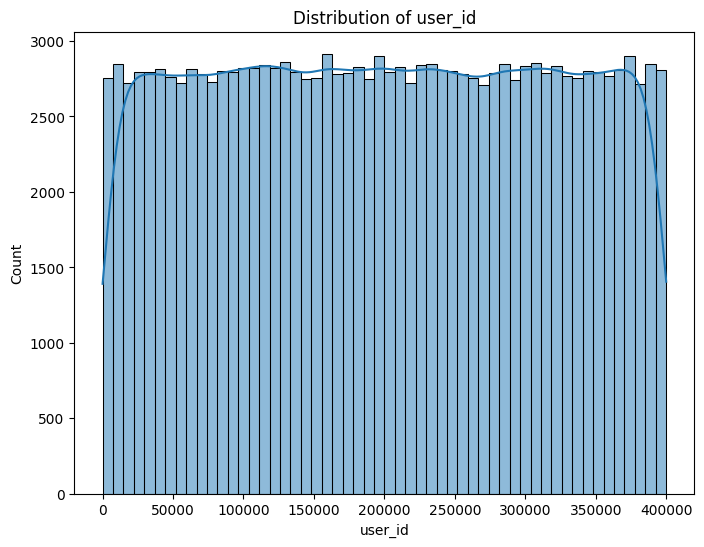

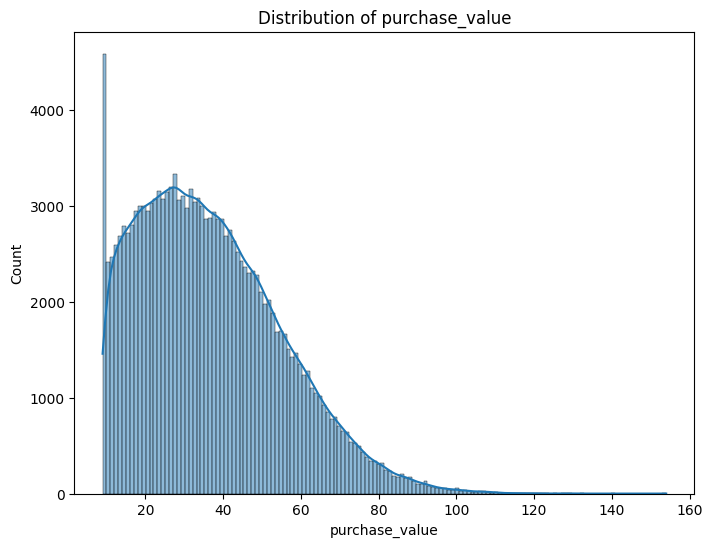

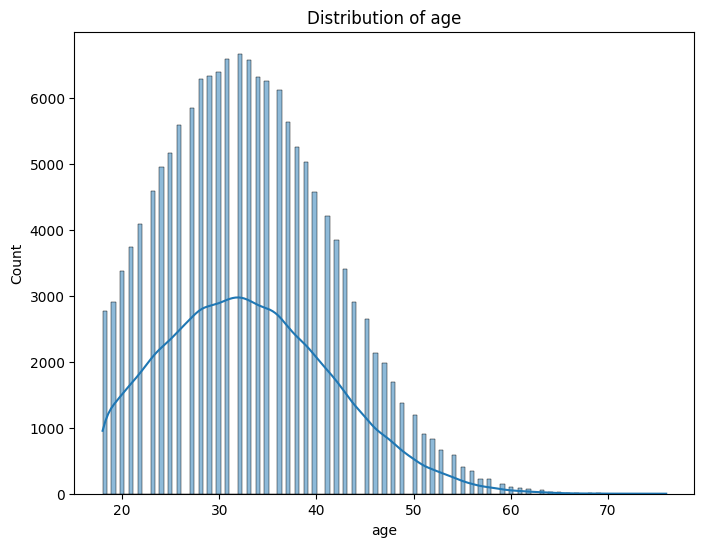

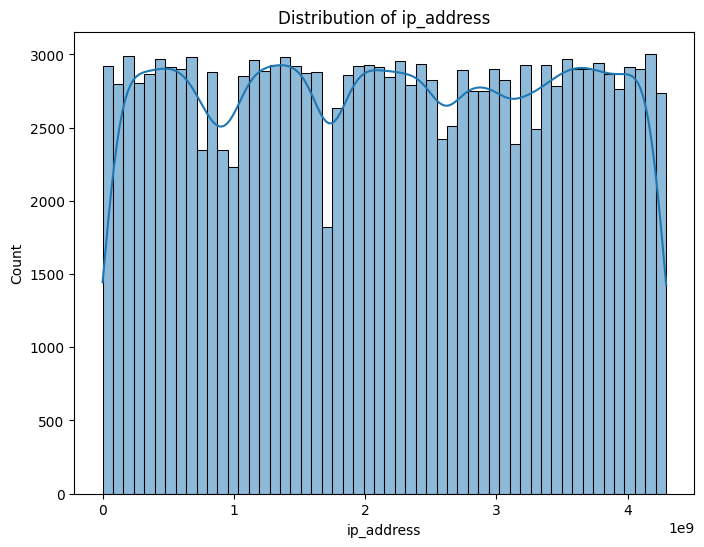

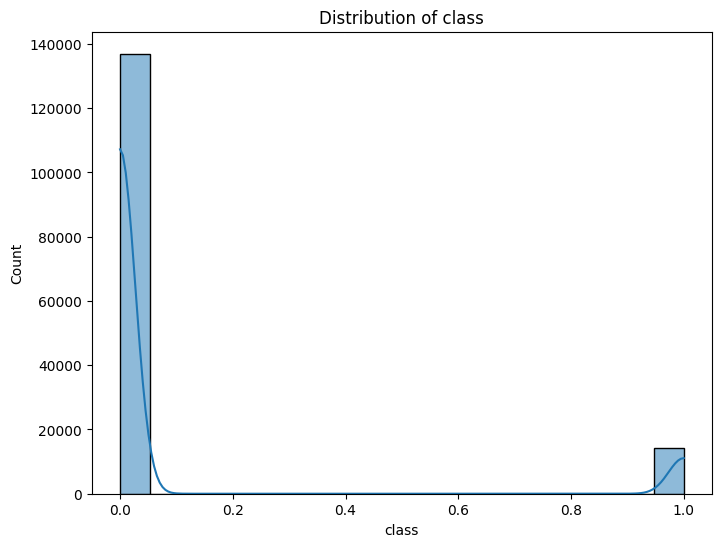

In [19]:
def pdf_univariate(df):
    # Visualize distributions of numerical features
    numerical_features = df.select_dtypes(include=[np.number]).columns.tolist()
    print(f"Numerical Features: {numerical_features}")
    for col in df.select_dtypes(include=np.number):
        plt.figure(figsize=(8, 6))
        sns.histplot(df[col], kde=True)
        plt.title(f'Distribution of {col}')
        plt.show()

pdf_univariate(fraud_data_df)

Numerical Features: ['user_id', 'purchase_value', 'age', 'ip_address', 'class']


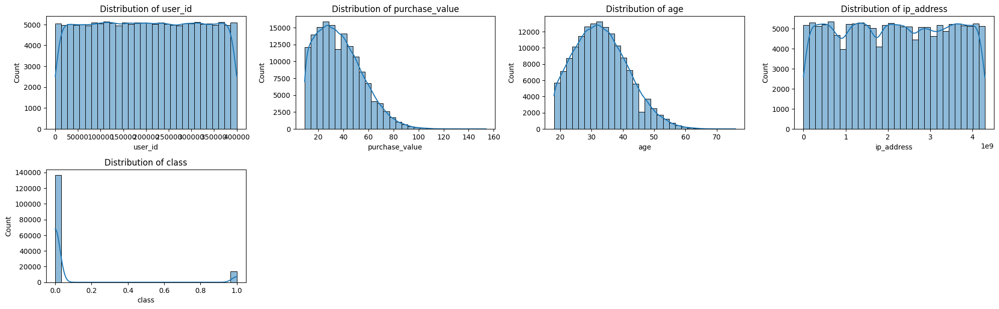

In [20]:
def plot_numerical_distribution(df):
    numerical_features = df.select_dtypes(include=[np.number]).columns.tolist()
    print(f"Numerical Features: {numerical_features}")

    plt.figure(figsize=(20, 15))
    for i, feature in enumerate(numerical_features):
        plt.subplot(5, 4, i + 1)
        sns.histplot(df[feature], kde=True, bins=30)
        plt.title(f'Distribution of {feature}')
    plt.tight_layout()
    plt.show()

# Plot numerical feature distribution
plot_numerical_distribution(fraud_data_df)

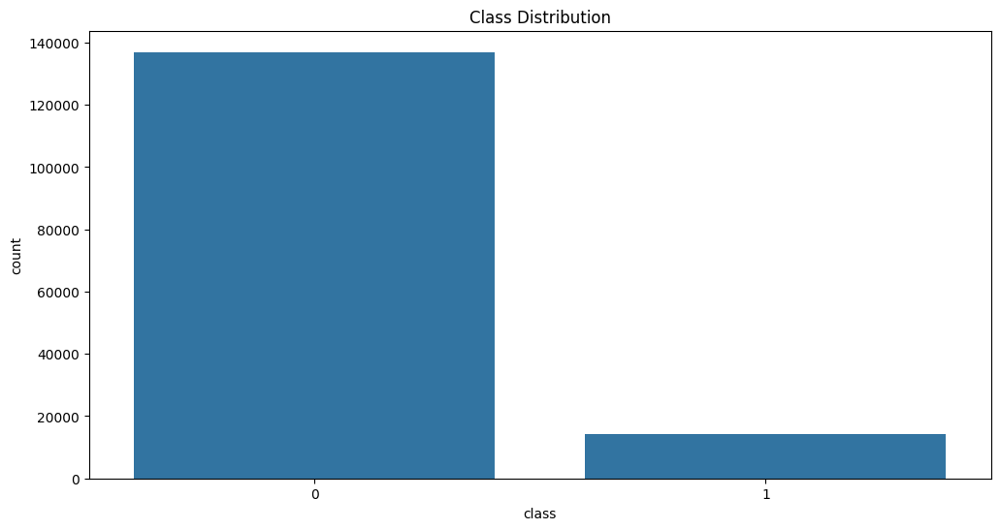

In [21]:
def univariate_analysis_2():
   plt.figure(figsize=(12, 6))
   sns.countplot(x='class', data=fraud_data_df)
   plt.title('Class Distribution')
   plt.show()
univariate_analysis_2()

###Bivariant

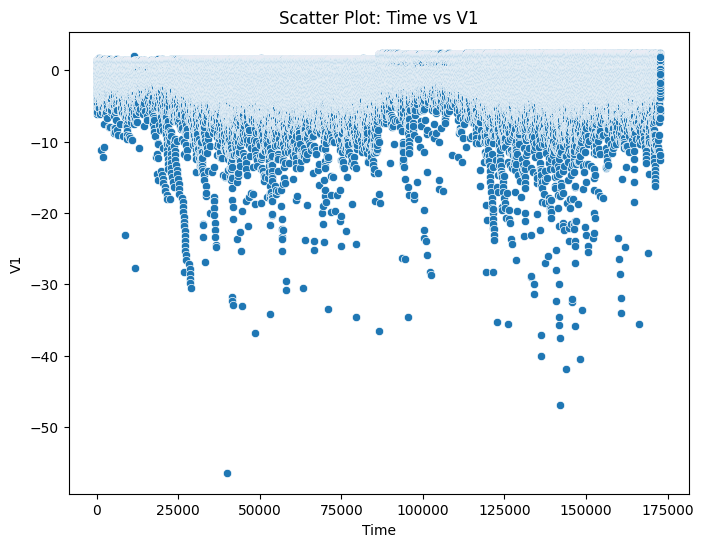

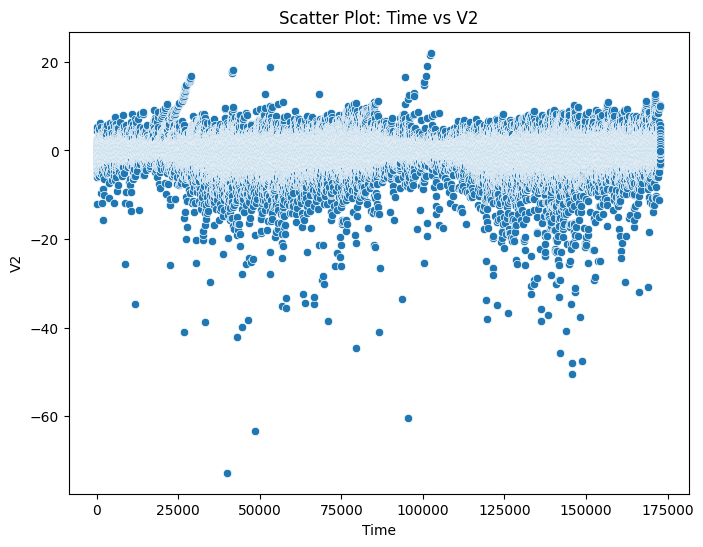

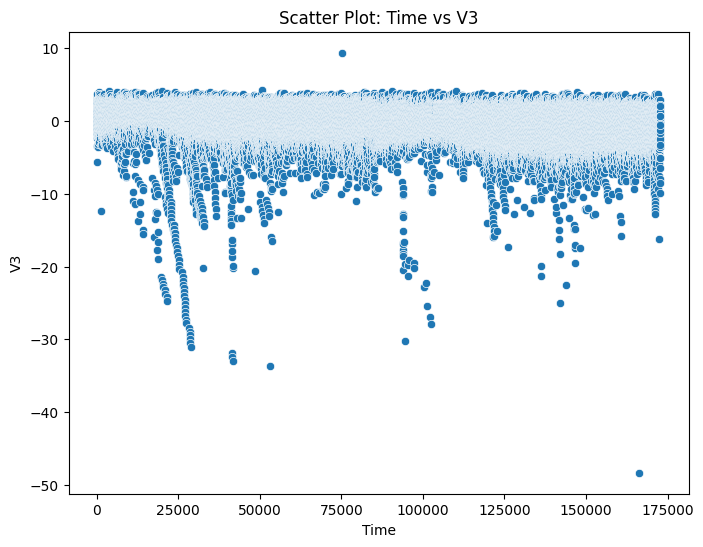

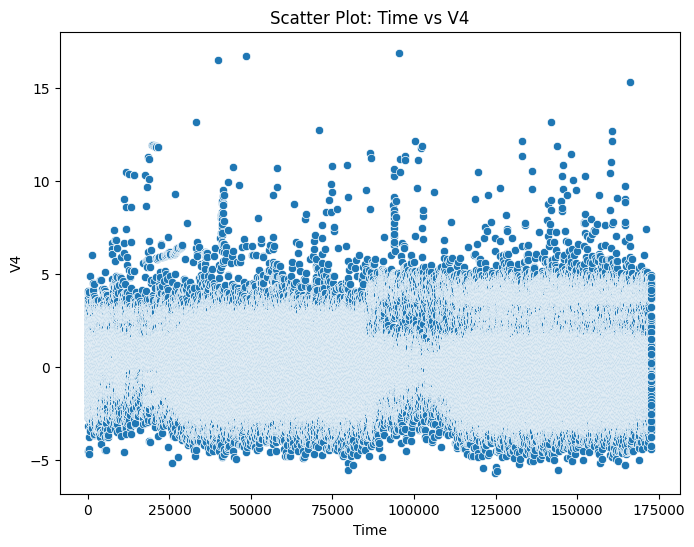

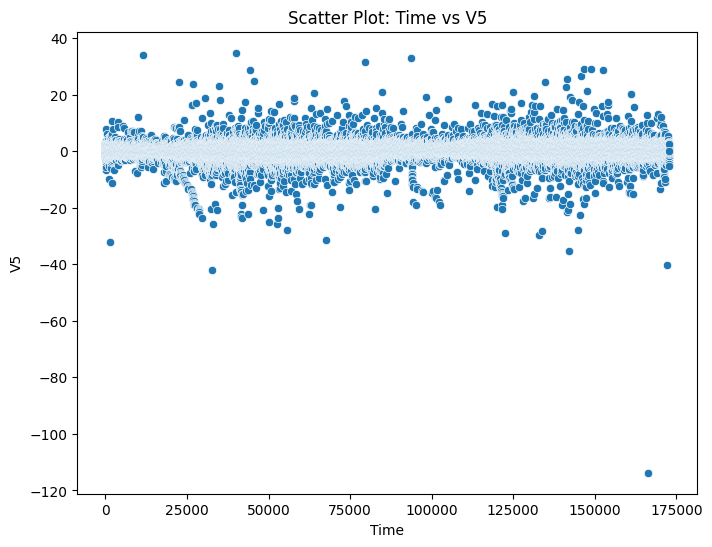

...

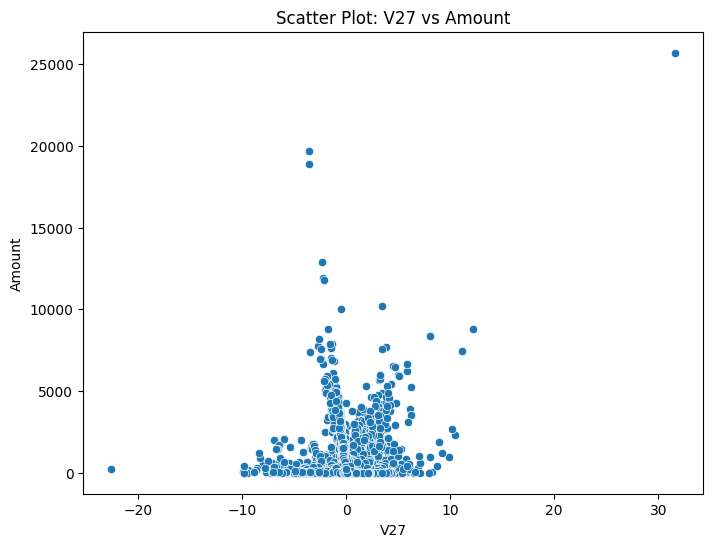

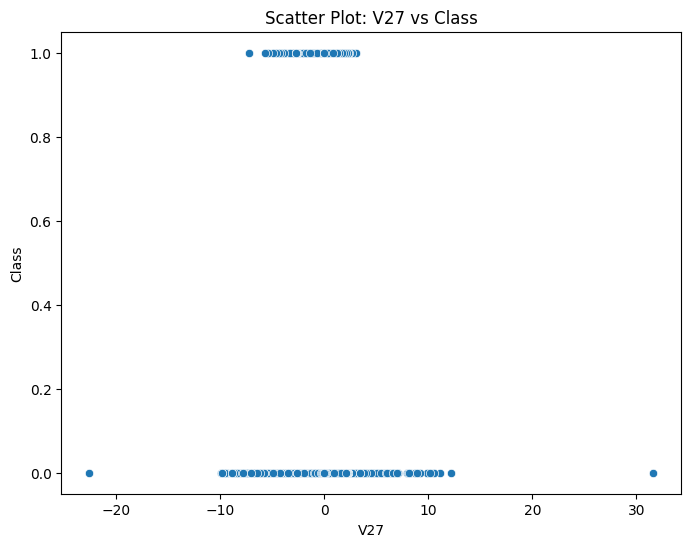

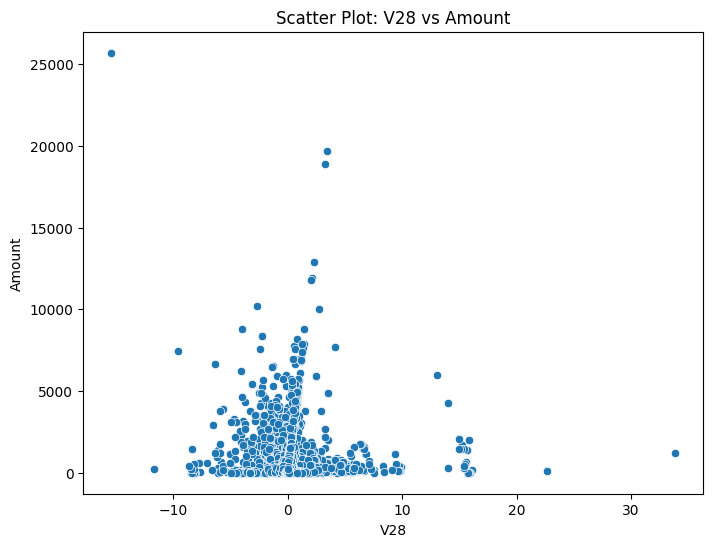

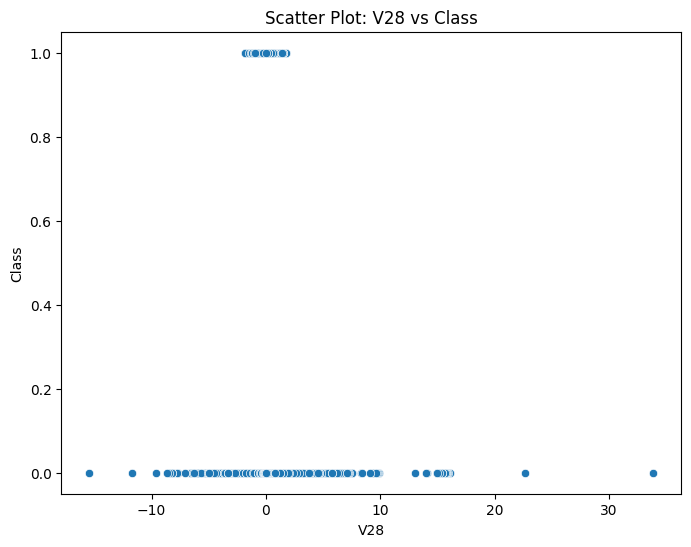

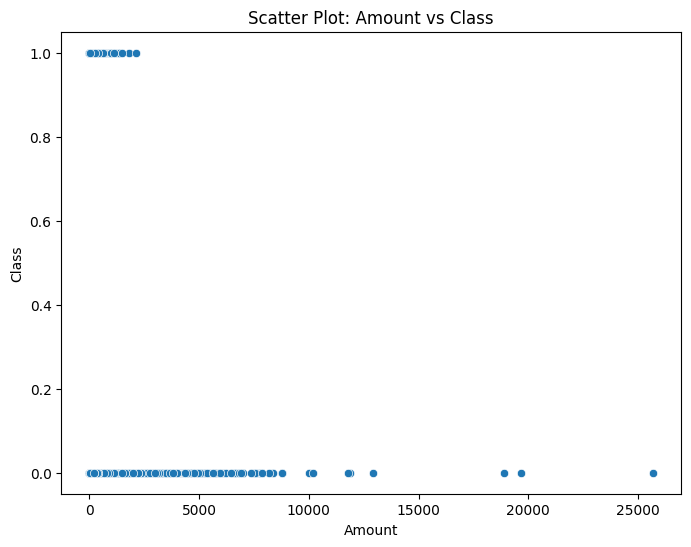

In [23]:
# Bivariate Analysis

# Scatter Plot for numerical vs. numerical
for i in range(len(numerical_colscredit)):
    for j in range(i + 1, len(numerical_colscredit)):
        plt.figure(figsize=(8, 6))
        sns.scatterplot(x=credit_card_df[numerical_colscredit[i]], y=credit_card_df[numerical_colscredit[j]])
        plt.title(f'Scatter Plot: {numerical_colscredit[i]} vs {numerical_colscredit[j]}')
        plt.xlabel(numerical_colscredit[i])
        plt.ylabel(numerical_colscredit[j])
        plt.show()

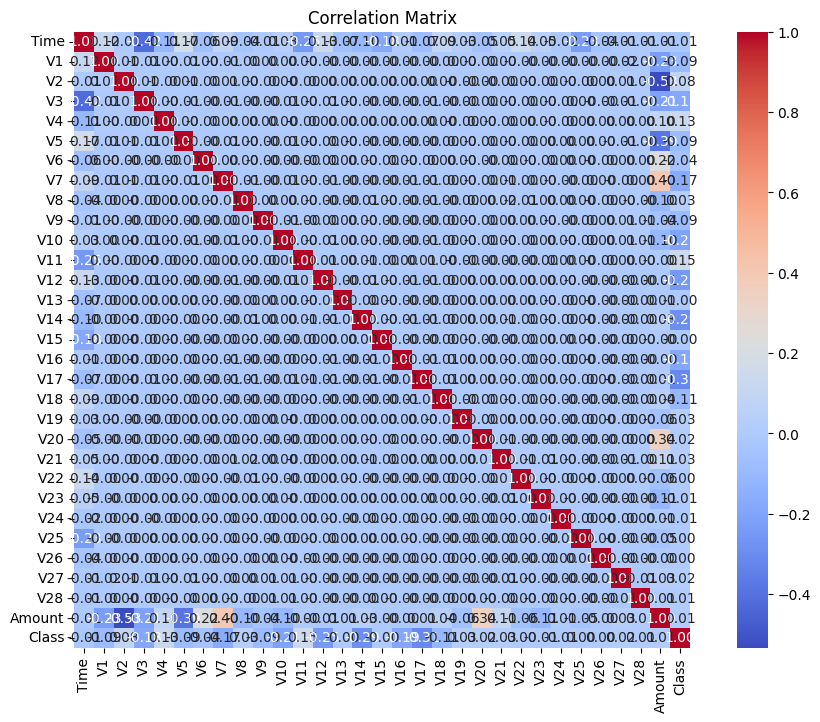

In [27]:

# Correlation Matrix for numerical columns
plt.figure(figsize=(12, 8))
correlation_matrix = credit_card_df[numerical_colscredit].corr()
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True)
plt.title('Correlation Matrix')
plt.show()

In [28]:
# Box Plot for categorical vs. numerical
for cat_col in categorical_cols:
    for num_col in numerical_colscredit:
        plt.figure(figsize=(8, 6))
        sns.boxplot(x=credit_card_df[cat_col], y=credit_card_df[num_col])
        plt.title(f'Box Plot: {num_col} by {cat_col}')
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.show()

###Explanation:
Univariate Analysis:
Numerical Variables: Histograms and box plots show distributions and potential outliers.
Categorical Variables: Count plots display the frequency of categories.
Bivariate Analysis:
Scatter Plots: Visualize relationships between pairs of numerical variables.
Correlation Matrix: Shows the strength and direction of relationships between numerical variables.
Box Plots: Compare numerical distributions across categories.

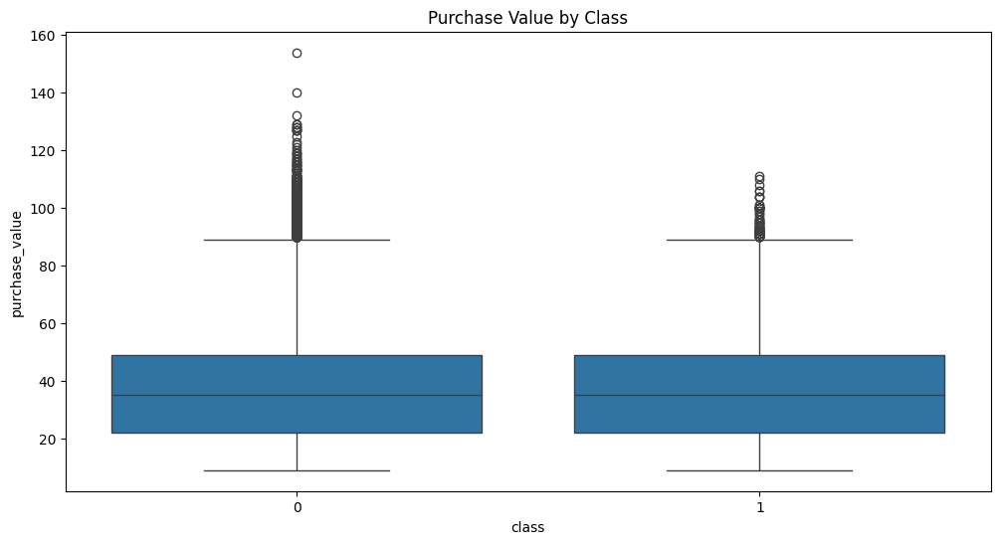

In [5]:
def bivariate_analysis_1():
 plt.figure(figsize=(12, 6))
 sns.boxplot(x='class', y='purchase_value', data=fraud_data_df)
 plt.title('Purchase Value by Class')
 plt.show()
bivariate_analysis_1()

###Merge DataSet for GeoLocation Analysis

###convert IP to Integer

In [7]:
# Merge Datasets for Geolocation Analysis
def convert_ip_to_integer(ip_address_df):
    
    ip_address_df['lower_bound_ip_address'] = ip_address_df['lower_bound_ip_address'].apply(int)
    ip_address_df['upper_bound_ip_address'] = ip_address_df['upper_bound_ip_address'].apply(int)
    
    return ip_address_df

# Example usage
ip_address_df = convert_ip_to_integer(ip_address_df)

In [8]:
fraud_data_df

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,age,ip_address,class
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,34,QVPSPJUOCKZAR,SEO,Chrome,M,39,7.327584e+08,0
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,16,EOGFQPIZPYXFZ,Ads,Chrome,F,53,3.503114e+08,0
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,15,YSSKYOSJHPPLJ,SEO,Opera,M,53,2.621474e+09,1
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,44,ATGTXKYKUDUQN,SEO,Safari,M,41,3.840542e+09,0
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,39,NAUITBZFJKHWW,Ads,Safari,M,45,4.155831e+08,0
...,...,...,...,...,...,...,...,...,...,...,...
151107,345170,2015-01-27 03:03:34,2015-03-29 00:30:47,43,XPSKTWGPWINLR,SEO,Chrome,M,28,3.451155e+09,1
151108,274471,2015-05-15 17:43:29,2015-05-26 12:24:39,35,LYSFABUCPCGBA,SEO,Safari,M,32,2.439047e+09,0
151109,368416,2015-03-03 23:07:31,2015-05-20 07:07:47,40,MEQHCSJUBRBFE,SEO,IE,F,26,2.748471e+09,0
151110,207709,2015-07-09 20:06:07,2015-09-07 09:34:46,46,CMCXFGRHYSTVJ,SEO,Chrome,M,37,3.601175e+09,0


In [9]:
fraud_data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 151112 entries, 0 to 151111
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   user_id         151112 non-null  int64  
 1   signup_time     151112 non-null  object 
 2   purchase_time   151112 non-null  object 
 3   purchase_value  151112 non-null  int64  
 4   device_id       151112 non-null  object 
 5   source          151112 non-null  object 
 6   browser         151112 non-null  object 
 7   sex             151112 non-null  object 
 8   age             151112 non-null  int64  
 9   ip_address      151112 non-null  float64
 10  class           151112 non-null  int64  
dtypes: float64(1), int64(4), object(6)
memory usage: 12.7+ MB


###Feature engineering

In [12]:

# Function to convert IP addresses to integer format
def ip_to_integer(ip):
    try:
        return int(ipaddress.ip_address(ip))
    except ValueError:
        return None  # Return None for invalid IPs

# Convert IP addresses in Fraud_Data to integer format
fraud_data_df['ip_integer'] = fraud_data_df['ip_address'].apply(ip_to_integer)

# Display the updated Fraud Data
print("\nFraud Data with IP Addresses Converted to Integer:")
print(fraud_data_df.head())



Fraud Data with IP Addresses Converted to Integer:
   user_id          signup_time        purchase_time  purchase_value  \
0    22058  2015-02-24 22:55:49  2015-04-18 02:47:11              34   
1   333320  2015-06-07 20:39:50  2015-06-08 01:38:54              16   
2     1359  2015-01-01 18:52:44  2015-01-01 18:52:45              15   
3   150084  2015-04-28 21:13:25  2015-05-04 13:54:50              44   
4   221365  2015-07-21 07:09:52  2015-09-09 18:40:53              39   

       device_id source browser sex  age    ip_address  class  \
0  QVPSPJUOCKZAR    SEO  Chrome   M   39  7.327584e+08      0   
1  EOGFQPIZPYXFZ    Ads  Chrome   F   53  3.503114e+08      0   
2  YSSKYOSJHPPLJ    SEO   Opera   M   53  2.621474e+09      1   
3  ATGTXKYKUDUQN    SEO  Safari   M   41  3.840542e+09      0   
4  NAUITBZFJKHWW    Ads  Safari   M   45  4.155831e+08      0   

   transaction_frequency ip_integer  
0                      1       None  
1                      1       None  
2         

In [14]:

# Convert lower and upper bound IP addresses to integer format in IpAddress_to_Country
ip_address_df['lower_bound_ip_address'] = ip_address_df['lower_bound_ip_address'].apply(ip_to_integer)
ip_address_df['upper_bound_ip_address'] = ip_address_df['upper_bound_ip_address'].apply(ip_to_integer)

# Ensure the columns are of the same type
fraud_data_df['ip_integer'] = fraud_data_df['ip_integer'].astype('Int64')  # Using Int64 for nullable integers
ip_address_df['lower_bound_ip_address'] = ip_address_df['lower_bound_ip_address'].astype('Int64')
ip_address_df['upper_bound_ip_address'] = ip_address_df['upper_bound_ip_address'].astype('Int64')


# Display updated IP Address to Country Data
print("\nIP Address to Country Data with Bounds Converted:")
print(ip_address_df.head())
# Merge datasets based on IP address ranges
merged_data = fraud_data_df.merge(ip_address_df, how='left', 
                                 left_on='ip_integer', 
                                 right_on='lower_bound_ip_address')

# Filter to keep only the rows where the IP is within the specified range
merged_data = merged_data[(merged_data['ip_integer'] >= merged_data['lower_bound_ip_address']) & 
                          (merged_data['ip_integer'] <= merged_data['upper_bound_ip_address'])]

# Display the merged DataFrame
print("\nMerged Data (Filtered):")
print(merged_data.head())


IP Address to Country Data with Bounds Converted:
   lower_bound_ip_address  upper_bound_ip_address    country
0                16777216                16777471  Australia
1                16777472                16777727      China
2                16777728                16778239      China
3                16778240                16779263  Australia
4                16779264                16781311      China

Merged Data (Filtered):
Empty DataFrame
Columns: [user_id, signup_time, purchase_time, purchase_value, device_id, source, browser, sex, age, ip_address, class, transaction_frequency, ip_integer, lower_bound_ip_address, upper_bound_ip_address, country]
Index: []


###Feature engineering

In [17]:

# Ensure the 'purchase_time' column is in datetime format
fraud_data_df['purchase_time'] = pd.to_datetime(fraud_data_df['purchase_time'])

# Feature Engineering

# 1. Transaction Frequency
# Group by user_id and count the number of transactions
transaction_frequency = fraud_data_df.groupby('user_id')['purchase_time'].count().reset_index()
transaction_frequency.columns = ['user_id', 'transaction_frequency']


In [16]:
fraud_data_df

,user_id,signup_time,purchase_time,purchase_value,device_id,source,browser,sex,age,ip_address,class,transaction_frequency,ip_integer
0,22058,2015-02-24 22:55:49,2015-04-18 02:47:11,34,QVPSPJUOCKZAR,SEO,Chrome,M,39,7.327584e+08,0,1,<NA>
1,333320,2015-06-07 20:39:50,2015-06-08 01:38:54,16,EOGFQPIZPYXFZ,Ads,Chrome,F,53,3.503114e+08,0,1,<NA>
2,1359,2015-01-01 18:52:44,2015-01-01 18:52:45,15,YSSKYOSJHPPLJ,SEO,Opera,M,53,2.621474e+09,1,1,<NA>
3,150084,2015-04-28 21:13:25,2015-05-04 13:54:50,44,ATGTXKYKUDUQN,SEO,Safari,M,41,3.840542e+09,0,1,<NA>
4,221365,2015-07-21 07:09:52,2015-09-09 18:40:53,39,NAUITBZFJKHWW,Ads,Safari,M,45,4.155831e+08,0,1,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...
151107,345170,2015-01-27 03:03:34,2015-03-29 00:30:47,43,XPSKTWGPWINLR,SEO,Chrome,M,28,3.451155e+09,1,1,<NA>
151108,274471,2015-05-15 17:43:29,2015-05-26 12:24:39,35,LYSFABUCPCGBA,SEO,Safari,M,32,2.439047e+09,0,1,<NA>
151109,368416,2015-03-03 23:07:31,2015-05-20 07:07:47,40,MEQHCSJUBRBFE,SEO,IE,F,26,2.748471e+09,0,1,<NA>
151110,207709,2015-07-09 20:06:07,2015-09-07 09:34:46,46,CMCXFGRHYSTVJ,SEO,Chrome,M,37,3.601175e+09,0,1,<NA>


In [18]:

# 2. Transaction Velocity
# Calculate total transaction value and average transaction value
transaction_velocity = fraud_data_df.groupby('user_id').agg(
    total_purchase_value=('purchase_value', 'sum'),
    average_purchase_value=('purchase_value', 'mean')
).reset_index()

# Merge both features into a single DataFrame
features = transaction_frequency.merge(transaction_velocity, on='user_id', how='left')

# Display the engineered features
print("\nEngineered Features (Transaction Frequency and Velocity):")
print(features.head())


Engineered Features (Transaction Frequency and Velocity):
   user_id  transaction_frequency  total_purchase_value  \
0        2                      1                    54   
1        4                      1                    41   
2        8                      1                    47   
3        9                      1                    62   
4       12                      1                    35   

   average_purchase_value  
0                    54.0  
1                    41.0  
2                    47.0  
3                    62.0  
4                    35.0  


In [19]:

# Optionally, you can merge these features back to the original Fraud Data
fraud_data = fraud_data_df.merge(features, on='user_id', how='left')

# Display the updated Fraud Data with engineered features
print("\nFraud Data with Engineered Features:")
print(fraud_data.head())


Fraud Data with Engineered Features:
   user_id          signup_time       purchase_time  purchase_value  \
0    22058  2015-02-24 22:55:49 2015-04-18 02:47:11              34   
1   333320  2015-06-07 20:39:50 2015-06-08 01:38:54              16   
2     1359  2015-01-01 18:52:44 2015-01-01 18:52:45              15   
3   150084  2015-04-28 21:13:25 2015-05-04 13:54:50              44   
4   221365  2015-07-21 07:09:52 2015-09-09 18:40:53              39   

       device_id source browser sex  age    ip_address  class  \
0  QVPSPJUOCKZAR    SEO  Chrome   M   39  7.327584e+08      0   
1  EOGFQPIZPYXFZ    Ads  Chrome   F   53  3.503114e+08      0   
2  YSSKYOSJHPPLJ    SEO   Opera   M   53  2.621474e+09      1   
3  ATGTXKYKUDUQN    SEO  Safari   M   41  3.840542e+09      0   
4  NAUITBZFJKHWW    Ads  Safari   M   45  4.155831e+08      0   

   transaction_frequency_x  ip_integer  transaction_frequency_y  \
0                        1        <NA>                        1   
1         

###Explanation:

Convert to Datetime: The purchase_time column is converted to datetime format to facilitate time-based calculations.
Transaction Frequency:
Count the number of purchases for each user_id.
Transaction Velocity:
Calculate the total and average purchase_value for each user_id.
Merge Features: Combine the frequency and velocity data into a single DataFrame.
Merge Back to Original Data: Optionally, merge the engineered features back into the original DataFrame for further analysis.

In [20]:

# Feature Engineering: Time-Based Features

# 1. Extract hour of the day from purchase_time
fraud_data['hour_of_day'] = fraud_data['purchase_time'].dt.hour

# 2. Extract day of the week from purchase_time
fraud_data['day_of_week'] = fraud_data['purchase_time'].dt.day_name()  # Returns the name of the day
# Alternatively, you can use dt.weekday to get the day as an integer (0=Monday, 6=Sunday)
# fraud_data['day_of_week'] = fraud_data['purchase_time'].dt.weekday

# Display the updated Fraud Data with time-based features
print("\nFraud Data with Time-Based Features:")
print(fraud_data[['user_id', 'purchase_time', 'hour_of_day', 'day_of_week']].head())


Fraud Data with Time-Based Features:
   user_id       purchase_time  hour_of_day day_of_week
0    22058 2015-04-18 02:47:11            2    Saturday
1   333320 2015-06-08 01:38:54            1      Monday
2     1359 2015-01-01 18:52:45           18    Thursday
3   150084 2015-05-04 13:54:50           13      Monday
4   221365 2015-09-09 18:40:53           18   Wednesday


In [21]:

# Select the column to be normalized/scaled
features_to_scale = fraud_data_df[['purchase_value']]

# 1. Normalization (Min-Max Scaling)
min_max_scaler = MinMaxScaler()
fraud_data_df['purchase_value_normalized'] = min_max_scaler.fit_transform(features_to_scale)

# 2. Standardization (Z-score Scaling)
standard_scaler = StandardScaler()
fraud_data_df['purchase_value_standardized'] = standard_scaler.fit_transform(features_to_scale)

# Display the updated Fraud Data with normalized and standardized features
print("\nFraud Data with Normalized and Standardized Features:")
print(fraud_data_df[['purchase_value', 'purchase_value_normalized', 'purchase_value_standardized']].head())


Fraud Data with Normalized and Standardized Features:
   purchase_value  purchase_value_normalized  purchase_value_standardized
0              34                   0.172414                    -0.160204
1              16                   0.048276                    -1.142592
2              15                   0.041379                    -1.197169
3              44                   0.241379                     0.385567
4              39                   0.206897                     0.112681


###Explanation:
Load the Dataset: Reads Fraud_Data.csv into a DataFrame.
Select Features to Scale: The purchase_value column is selected for scaling.
Normalization:
The MinMaxScaler from sklearn.preprocessing is used to scale the purchase_value to a range of [0, 1]. The normalized values are stored in a new column purchase_value_normalized.
Standardization:
The StandardScaler is used to standardize the purchase_value to have a mean of 0 and a standard deviation of 1. The standardized values are stored in a new column purchase_value_standardized.
Display Results: The updated DataFrame is displayed, showing the original and scaled features.

In [22]:

# 1. Label Encoding (example for ordinal data)
# Suppose 'sex' is an ordinal feature
fraud_data['sex_encoded'] = fraud_data['sex'].map({'male': 1, 'female': 0})

# 2. One-Hot Encoding (example for nominal data)
# Using get_dummies to one-hot encode 'source', 'browser', etc.
fraud_data = pd.get_dummies(fraud_data, columns=['source', 'browser'], drop_first=True)

# Display the updated Fraud Data with encoded features
print("\nFraud Data with Encoded Features:")
print(fraud_data.head())


Fraud Data with Encoded Features:
   user_id          signup_time       purchase_time  purchase_value  \
0    22058  2015-02-24 22:55:49 2015-04-18 02:47:11              34   
1   333320  2015-06-07 20:39:50 2015-06-08 01:38:54              16   
2     1359  2015-01-01 18:52:44 2015-01-01 18:52:45              15   
3   150084  2015-04-28 21:13:25 2015-05-04 13:54:50              44   
4   221365  2015-07-21 07:09:52 2015-09-09 18:40:53              39   

       device_id sex  age    ip_address  class  transaction_frequency_x  ...  \
0  QVPSPJUOCKZAR   M   39  7.327584e+08      0                        1  ...   
1  EOGFQPIZPYXFZ   F   53  3.503114e+08      0                        1  ...   
2  YSSKYOSJHPPLJ   M   53  2.621474e+09      1                        1  ...   
3  ATGTXKYKUDUQN   M   41  3.840542e+09      0                        1  ...   
4  NAUITBZFJKHWW   M   45  4.155831e+08      0                        1  ...   

   average_purchase_value  hour_of_day  day_of_week  sex_